# 이미지 처리 (Image Processing)

- 필요에 따라 적절한 처리 

- `resize()`, `flip()`, `getAffineTransform()`, `warpAffine()` 등 다양한 메서드 존재

## Resize

`cv2.resize()`

- 사이즈가 변하면 pixel사이의 값을 결정을 해야함
  
- 보간법(Interpolation method)
  - 사이즈를 줄일 때 : `cv2.INTER_AREA` 
  - 사이즈를 크게 할 때 : `cv2.INTER_CUBIC` , `cv2.INTER_LINEAR`

|파라미터|설명|
|--------|----|
|`img`|Image|
|`dsize`|Manual Size, 가로, 세로 형태의 tuple(e.g., (100,200))|
|`fx`|가로 사이즈의 배수, 2배로 크게하려면 2. 반으로 줄이려면 0.5|
|`fy`|세로 사이즈의 배수|
|`interpolation`|보간법|

- Moon.jpg (https://cdn.pixabay.com/photo/2021/06/26/06/52/moon-6365467_960_720.jpg)

  <img src="https://cdn.pixabay.com/photo/2021/06/26/06/52/moon-6365467_960_720.jpg" width="300">

In [ ]:
!wget -O moon.jpg https://cdn.pixabay.com/photo/2021/06/26/06/52/moon-6365467_960_720.jpg

--2022-02-21 13:21:10--  https://cdn.pixabay.com/photo/2021/06/26/06/52/moon-6365467_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.20.183, 104.18.21.183, 2606:4700::6812:15b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.20.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 80627 (79K) [image/jpeg]
Saving to: ‘moon.jpg’

moon.jpg            100%[===================>]  78.74K  --.-KB/s    in 0.008s  

2022-02-21 13:21:10 (9.32 MB/s) - ‘moon.jpg’ saved [80627/80627]



In [ ]:
image = cv2.imread('/content/moon.jpg')
print(image.shape)

(640, 960, 3)


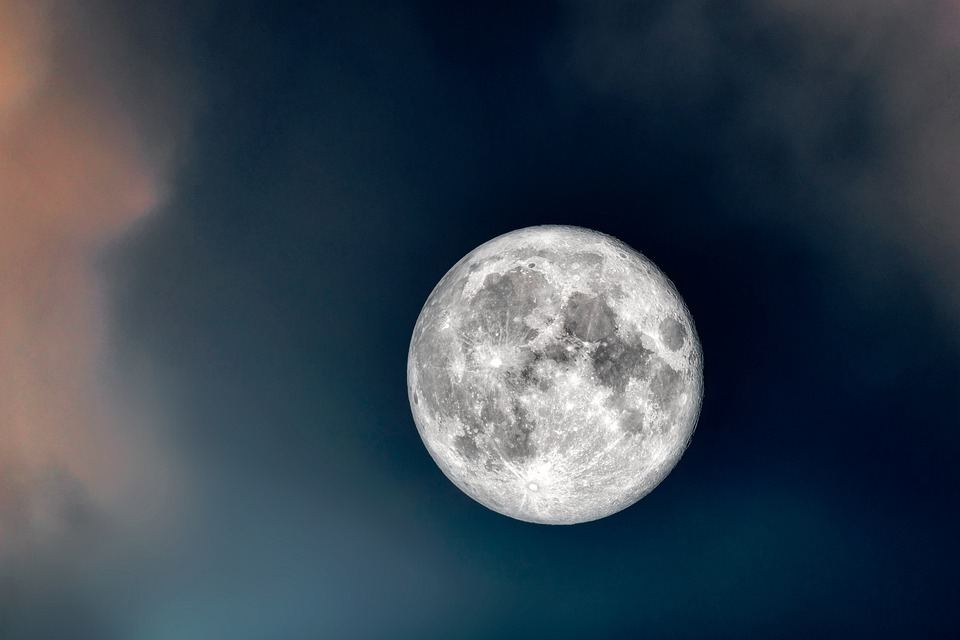

In [ ]:
cv2_imshow(image)

In [ ]:
height, width = image.shape[:2]

In [ ]:
shrink = cv2.resize(image, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_AREA)
zoom1 = cv2.resize(image, (width*2, height*2), interpolation=cv2.INTER_CUBIC)
zoom2 = cv2.resize(image, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)

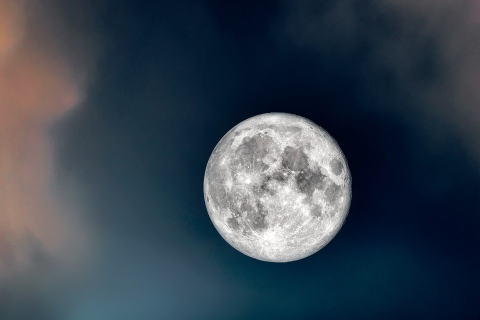

(320, 480, 3)


In [ ]:
cv2_imshow(shrink)
print(shrink.shape)

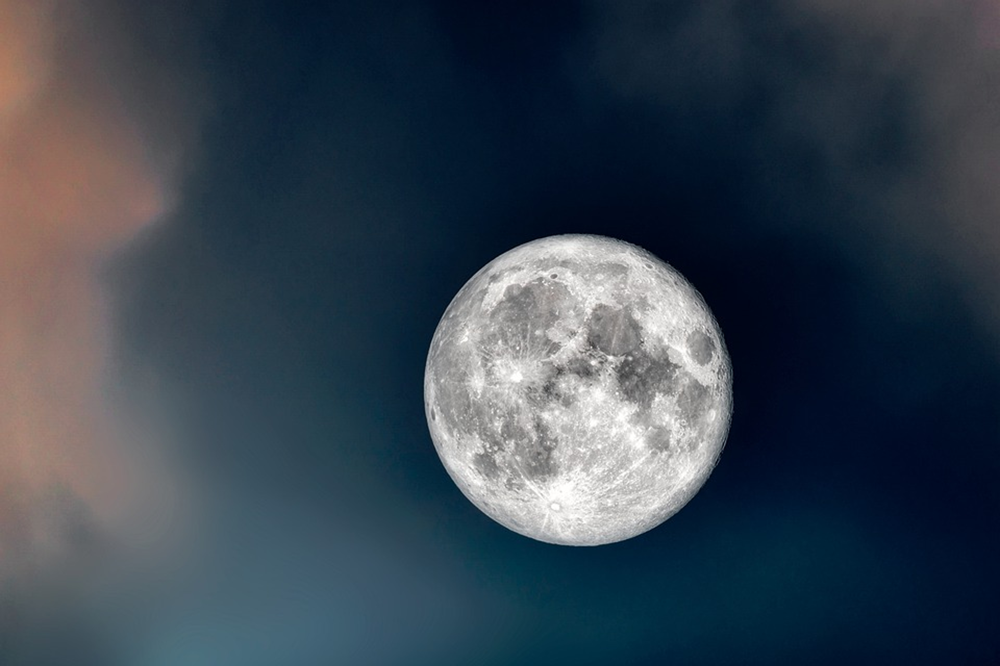

(1280, 1920, 3)


In [ ]:
cv2_imshow(zoom1)
print(zoom1.shape)

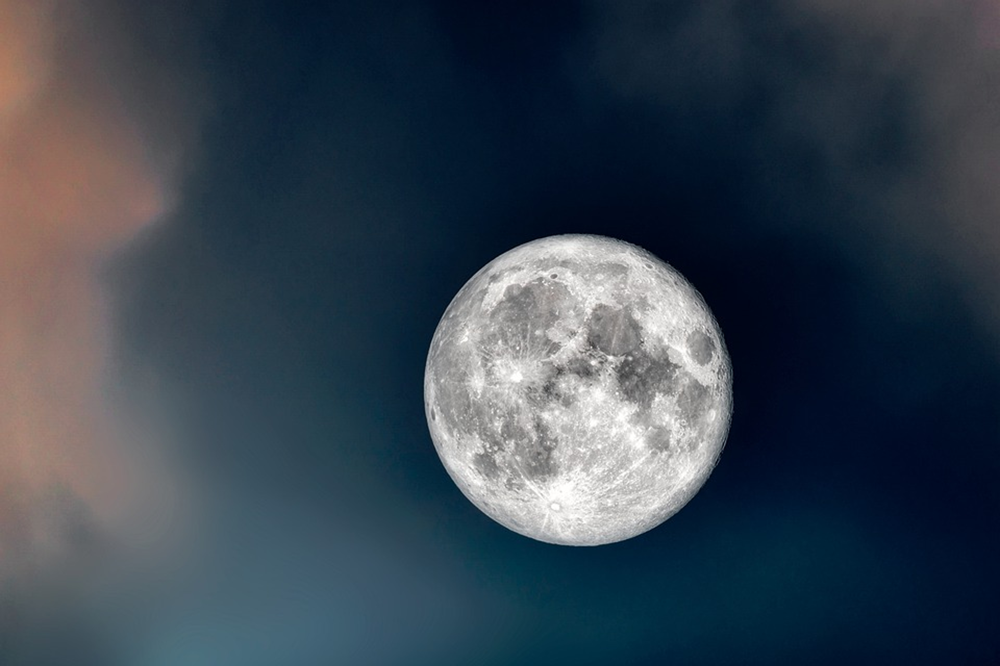

(1280, 1920, 3)


In [ ]:
cv2_imshow(zoom2)
print(zoom2.shape)

## Translation

 `cv2.warpAffine()`

- 이미지의 위치를 변경

|파라미터|설명|
|--------|----|
|`src`|Image|
|`M`|변환 행렬|
|`dsize` (tuple)|output image size(e.g., (width=columns, height=rows)|


In [ ]:
rows, cols = image.shape[:2]

M = np.float32([[1, 0, 20], [0, 1, 40]])
dst = cv2.warpAffine(image, M, (cols,rows))

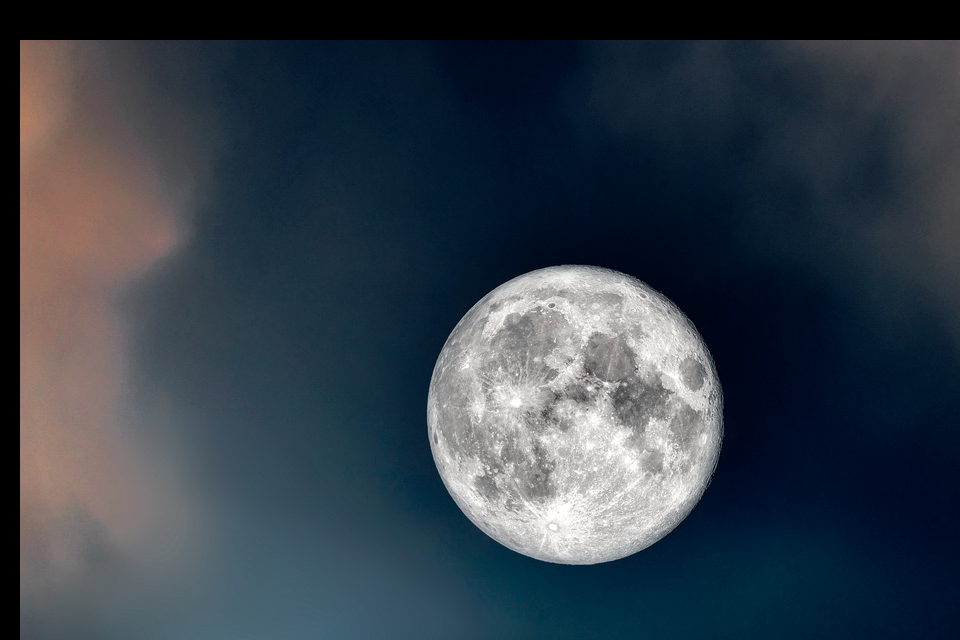

In [ ]:
cv2_imshow(dst)

## Rotate

`cv2.getRotationMatrix2D()`

- 물체를 평면상의 한 점을 중심으로 𝜃 만큼 회전하는 변환
- 양의 각도는 시계반대방향으로 회전

|파라미터|설명|
|--------|----|
|`center`|이미지의 중심 좌표|
|`angle`|회전 각도|
|`scale`|scale factor|

In [ ]:
print(image.shape)

(640, 960, 3)


In [ ]:
rows, cols = image.shape[:2]

M = cv2.getRotationMatrix2D((cols/2, rows/2), 60, 0.5)
dst = cv2.warpAffine(image, M, (cols,rows))

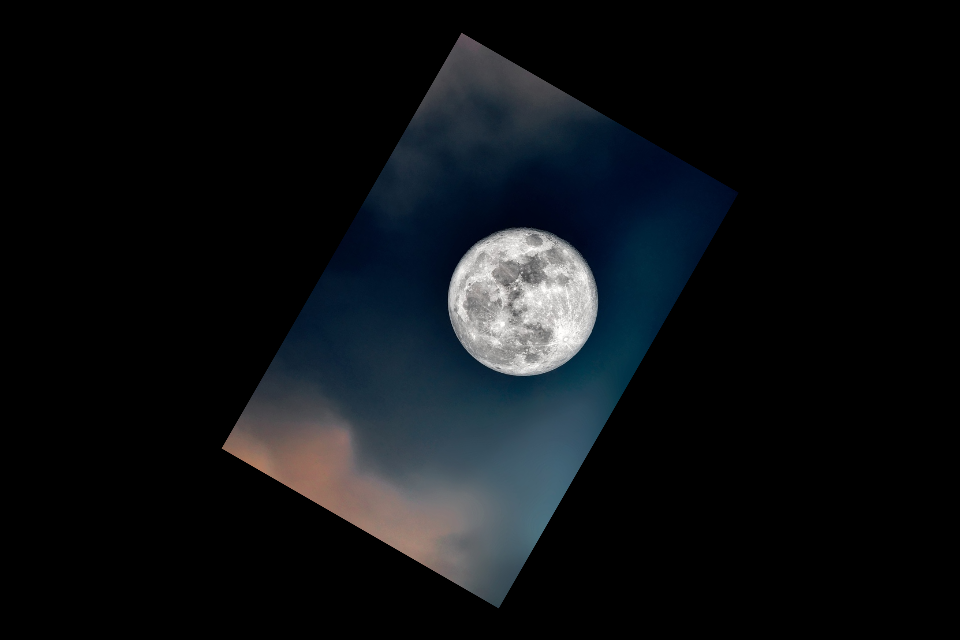

(640, 960, 3)


In [ ]:
cv2_imshow(dst)
print(dst.shape)

## Flip

`cv2.flip()`

- 대칭 변환
  - 좌우 대칭 (좌우 반전)
  - 상하 대칭 (상하 반전)

- 입력 영상과 출력 영상의 픽셀이 1:1 매칭이므로 보간법이 필요 없음

|파라미터|설명|
|--------|----|
|`src`|입력 영상|
|`flipCode`|대칭 방법을 결정하는 flag 인자, 양수이면 좌우 대칭, 0이면 상하 대칭, 음수이면 상하, 좌우 대칭을 모두 실행|

In [ ]:
img = cv2.imread('/content/moon.jpg')
print(img.shape)

(640, 960, 3)


In [ ]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

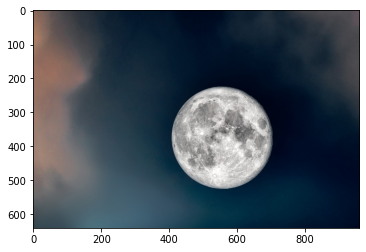

In [ ]:
plt.imshow(img)
plt.show()

In [ ]:
result1 = cv2.flip(img, 1)

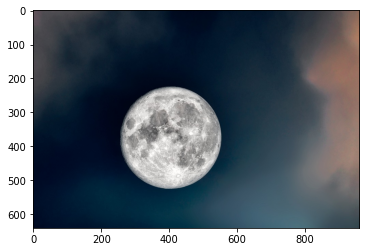

In [ ]:
plt.imshow(result1)
plt.show()

In [ ]:
result2 = cv2.flip(img, 0)

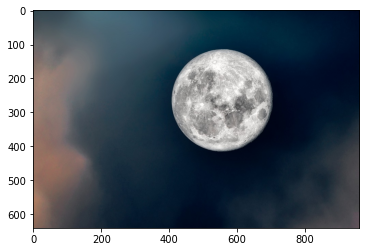

In [ ]:
plt.imshow(result2)
plt.show()

In [ ]:
result3 = cv2.flip(img, -1)

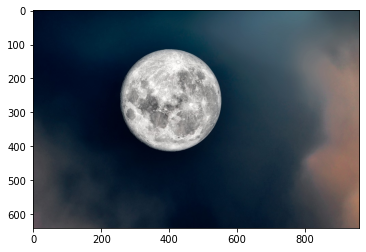

In [ ]:
plt.imshow(result3)
plt.show()

## Affine Transformation

`cv2.getAffineTransform()`

- 선의 평행선은 유지되면서 이미지를 변환하는 작업
- 이동, 확대, Scale, 반전까지 포함된 변환
- Affine 변환을 위해서는 3개의 Match가 되는 점이 있으면 변환행렬을 구할 수 있음

In [ ]:
rows, cols, ch = img.shape

pts1 = np.float32([[200, 100], [400, 100], [200, 200]])
pts2 = np.float32([[200, 300], [400, 200], [200, 400]])

cv2.circle(image, (200, 100), 10, (255, 0, 0), -1) 
cv2.circle(image, (400, 100), 10, (0, 255, 0), -1)
cv2.circle(image, (200, 200), 10, (0, 0, 255), -1)

M = cv2.getAffineTransform(pts1, pts2)

dst = cv2.warpAffine(image, M, (cols, rows))

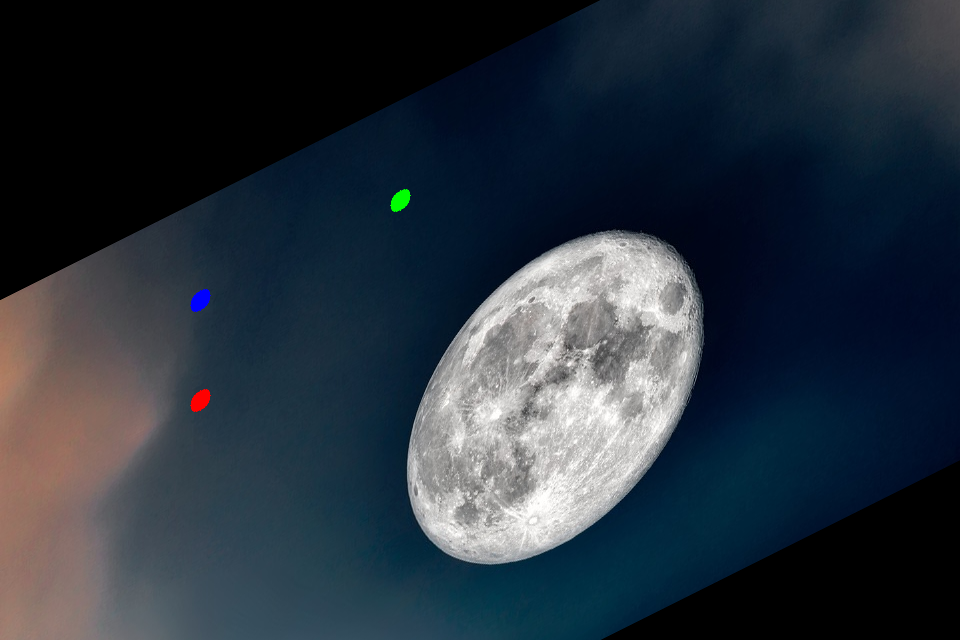

(640, 960, 3)


In [ ]:
cv2_imshow(dst)
print(dst.shape)

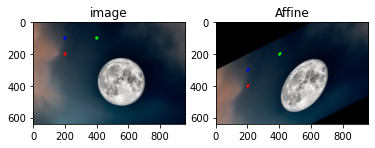

In [ ]:
plt.subplot(121)
plt.imshow(image[:, :, ::-1])
plt.title('image')

plt.subplot(122) 
plt.imshow(dst[:, :, ::-1])
plt.title('Affine')

plt.show()

## Perspective Transformation

- Perspective(원근법) 변환
- 직선의 성질만 유지, 선의 평행성은 유지가 되지 않는 변환
- 기차길은 서로 평행하지만 원근변환을 거치면 평행성은 유지 되지 못하고 하나의 점에서 만나는 것 처럼 보임 (반대의 변환도 가능)
- 4개의 Point의 Input값과 이동할 output Point 가 필요
- `cv2.getPerspectiveTransform()`가 필요하며, `cv2.warpPerspective()` 함수에 변환행렬값을 적용하여 최종 결과 이미지를 얻을 수 있음


- train.jpg (https://cdn.pixabay.com/photo/2015/04/04/06/54/train-706219_960_720.jpg)

  <img src="https://cdn.pixabay.com/photo/2015/04/04/06/54/train-706219_960_720.jpg" width="200">


In [ ]:
!wget -O train.jpg https://cdn.pixabay.com/photo/2015/04/04/06/54/train-706219_960_720.jpg

--2022-02-21 13:21:15--  https://cdn.pixabay.com/photo/2015/04/04/06/54/train-706219_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.21.183, 104.18.20.183, 2606:4700::6812:15b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.21.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 136421 (133K) [image/jpeg]
Saving to: ‘train.jpg’

train.jpg           100%[===================>] 133.22K  --.-KB/s    in 0.01s   

2022-02-21 13:21:15 (10.3 MB/s) - ‘train.jpg’ saved [136421/136421]



In [ ]:
road = cv2.imread('/content/train.jpg')

In [ ]:
print(road.shape)

(720, 481, 3)


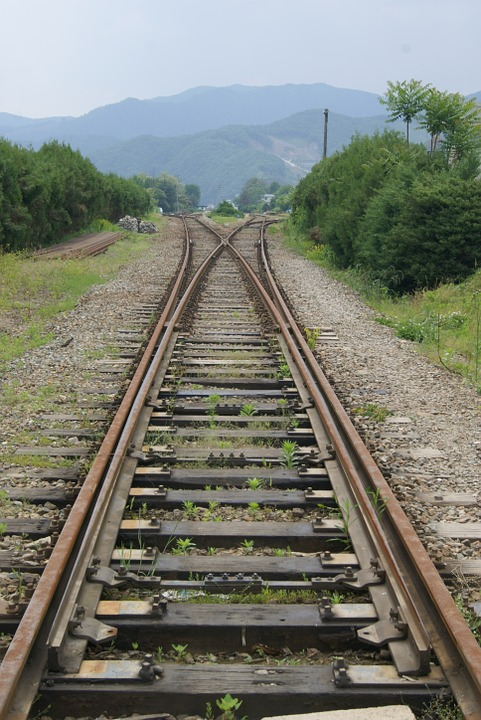

In [ ]:
cv2_imshow(road)

- 좌표점은 (왼쪽 위)→(오른쪽 위)→(오른쪽 아래)→(왼쪽 아래)

In [ ]:
top_left = (180, 300)
top_right = (270, 300)
bottom_left = (80, 550)
bottom_right = (400, 550)

pts1 = np.float32([top_left, top_right, bottom_right, bottom_left])

w1 = abs(bottom_right[0] - bottom_left[0])
w2 = abs(top_right[0] - top_left[0])
h1 = abs(top_right[1] - bottom_right[1])
h2 = abs(top_left[1] - bottom_left[1])

max_width = max([w1, w2])
max_height= max([h1, h2])

pts2 = np.float32([[0, 0],
                  [max_width-1, 0],
                  [max_width-1, max_height-1],
                  [0, max_height-1]])

In [ ]:
cv2.circle(road, top_left, 10, (255, 0, 0), -1)
cv2.circle(road, top_right, 10, (0, 255, 0), -1)
cv2.circle(road, bottom_right, 10, (0, 0, 255), -1)
cv2.circle(road, bottom_left, 10, (255, 255, 255), -1)

array([[[244, 233, 225],
        [244, 233, 225],
        [244, 233, 225],
        ...,
        [228, 210, 199],
        [228, 210, 199],
        [228, 211, 198]],

       [[244, 233, 225],
        [244, 233, 225],
        [244, 233, 225],
        ...,
        [228, 210, 199],
        [228, 210, 199],
        [228, 211, 198]],

       [[244, 233, 225],
        [244, 233, 225],
        [244, 233, 225],
        ...,
        [228, 210, 199],
        [228, 210, 199],
        [228, 210, 199]],

       ...,

       [[ 44,  67,  89],
        [ 43,  67,  87],
        [ 42,  66,  84],
        ...,
        [ 64,  91, 117],
        [ 67,  91, 115],
        [ 62,  82, 107]],

       [[ 43,  67,  87],
        [ 43,  67,  87],
        [ 41,  65,  83],
        ...,
        [ 66,  95, 122],
        [ 70,  95, 121],
        [ 62,  84, 109]],

       [[ 43,  67,  87],
        [ 43,  67,  87],
        [ 40,  64,  82],
        ...,
        [ 64,  93, 120],
        [ 64,  91, 117],
        [ 66,  87, 114]]

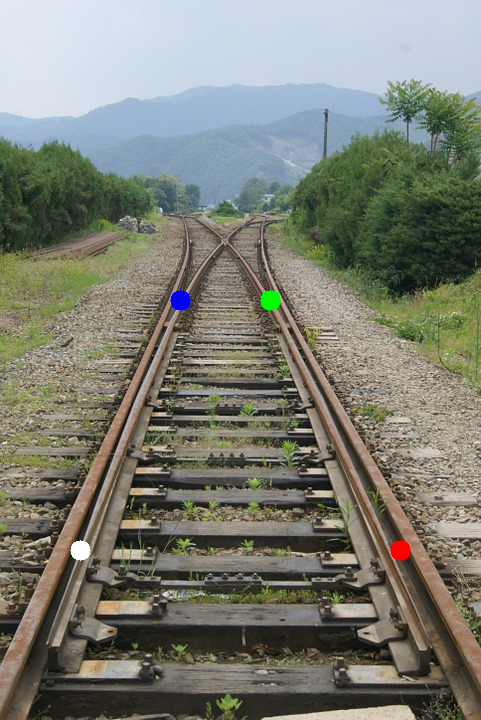

In [ ]:
cv2_imshow(road)

In [ ]:
M = cv2.getPerspectiveTransform(pts1, pts2)

dst = cv2.warpPerspective(road, M, (max_width, max_height))

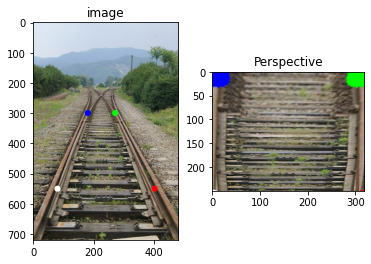

In [ ]:
plt.subplot(121)
plt.imshow(road[:, :, ::-1])
plt.title('image')

plt.subplot(122)
plt.imshow(dst[:, :, ::-1])
plt.title('Perspective')

plt.show()

# 이미지 연산 (Image Operation)

- 이미지는 배열(array)로 표현가능하여 여러가지 연산 가능

  - tree.jpg (https://cdn.pixabay.com/photo/2020/08/22/00/24/desert-5507220_960_720.jpg)

  <img src="https://cdn.pixabay.com/photo/2020/08/22/00/24/desert-5507220_960_720.jpg" width="400">


In [ ]:
!wget -O tree.jpg https://cdn.pixabay.com/photo/2020/08/22/00/24/desert-5507220_960_720.jpg

--2022-02-21 13:21:16--  https://cdn.pixabay.com/photo/2020/08/22/00/24/desert-5507220_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.20.183, 104.18.21.183, 2606:4700::6812:15b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.20.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 294089 (287K) [image/jpeg]
Saving to: ‘tree.jpg’

tree.jpg            100%[===================>] 287.20K  --.-KB/s    in 0.02s   

2022-02-21 13:21:16 (15.3 MB/s) - ‘tree.jpg’ saved [294089/294089]



In [ ]:
tree = cv2.imread('/content/tree.jpg')
print(tree.shape)

(646, 960, 3)


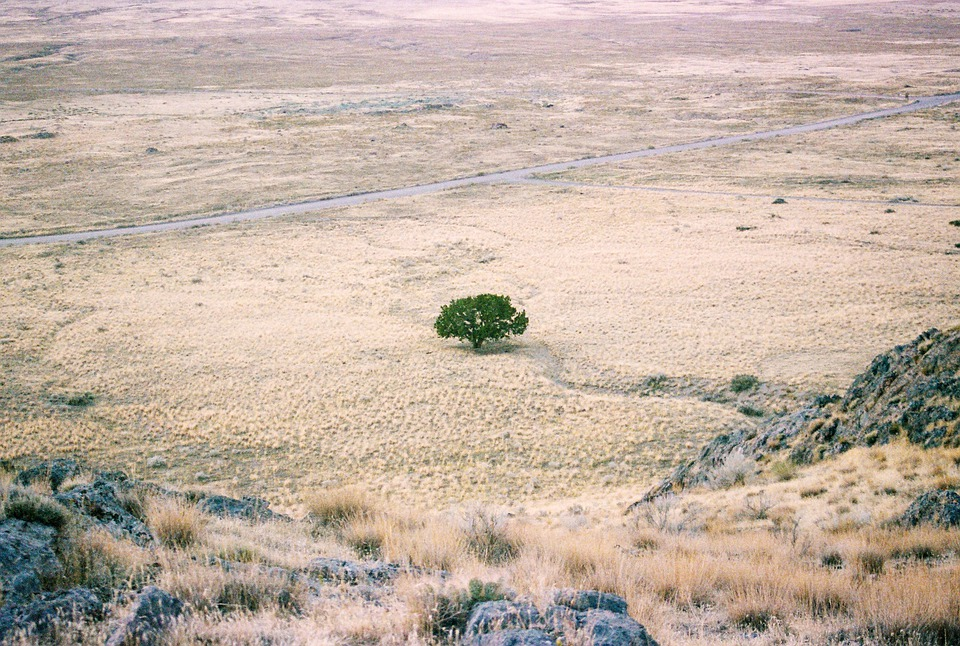

In [ ]:
cv2_imshow(tree)

## Pixel Value

In [ ]:
temp_px = tree[200, 200]
print(temp_px)

[160 174 192]


In [ ]:
temp_channel = tree[200, 200, 2]
print(temp_channel)

192


## 값 변경

In [ ]:
tree[100, 100] = [0, 0, 255]
tree[191, 100] = [0, 0, 255]
tree[102, 100] = [0, 0, 255]
tree[103, 100] = [0, 0, 255]
tree[104, 100] = [0, 0, 255]

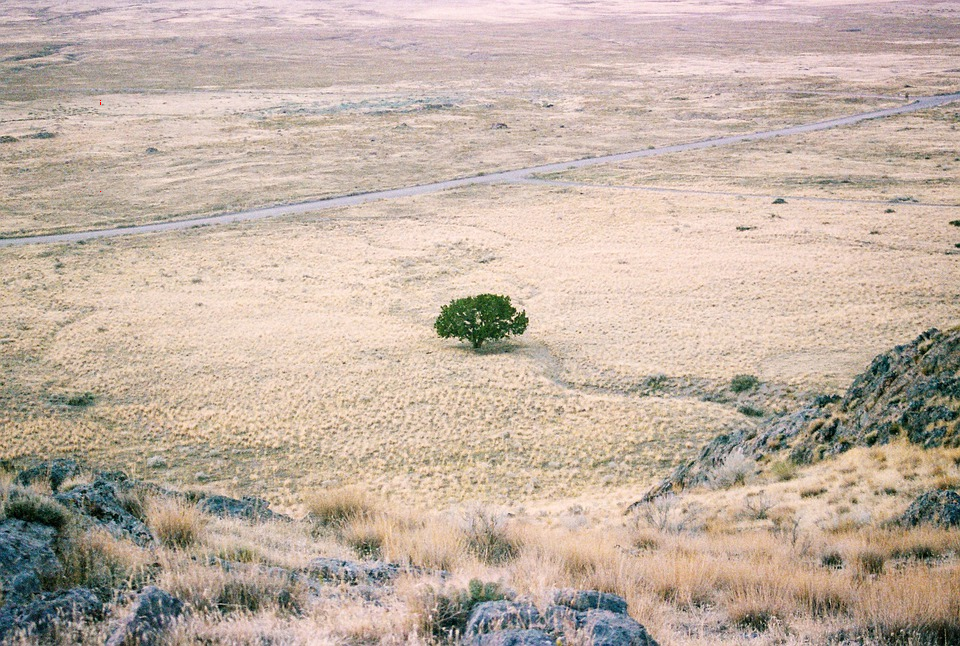

In [ ]:
cv2_imshow(tree)

## 인덱싱

In [ ]:
print(tree[:100, :100].shape)

(100, 100, 3)


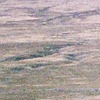

In [ ]:
cv2_imshow(tree[:100, :100])

In [ ]:
white_box = tree[:100, :100]
white_box = [255, 255, 255]
tree[:100, :100] = white_box

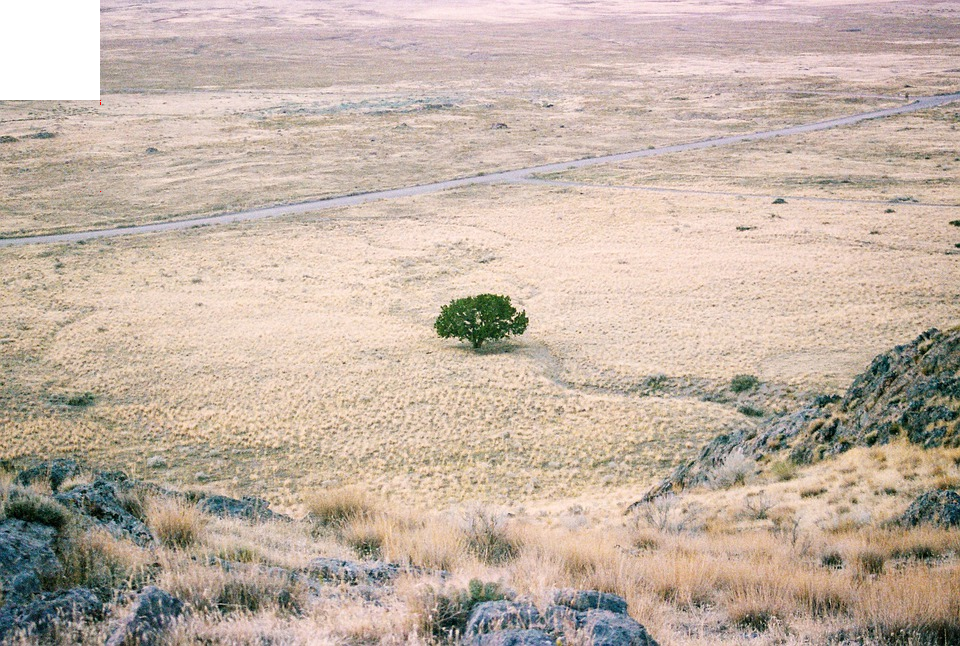

In [ ]:
cv2_imshow(tree)

## 이미지 ROI

- 이미지 작업시에는 특정 pixel단위 보다는 특정 영역단위로 작업을 하게 되는데 이것을 Region of Image(ROI)라고 함
- ROI 설정은 Numpy의 indexing을 사용, 특정 영역을 copy 할 수도 있음

In [ ]:
tree = cv2.imread('/content/tree.jpg')
print(tree.shape)

(646, 960, 3)


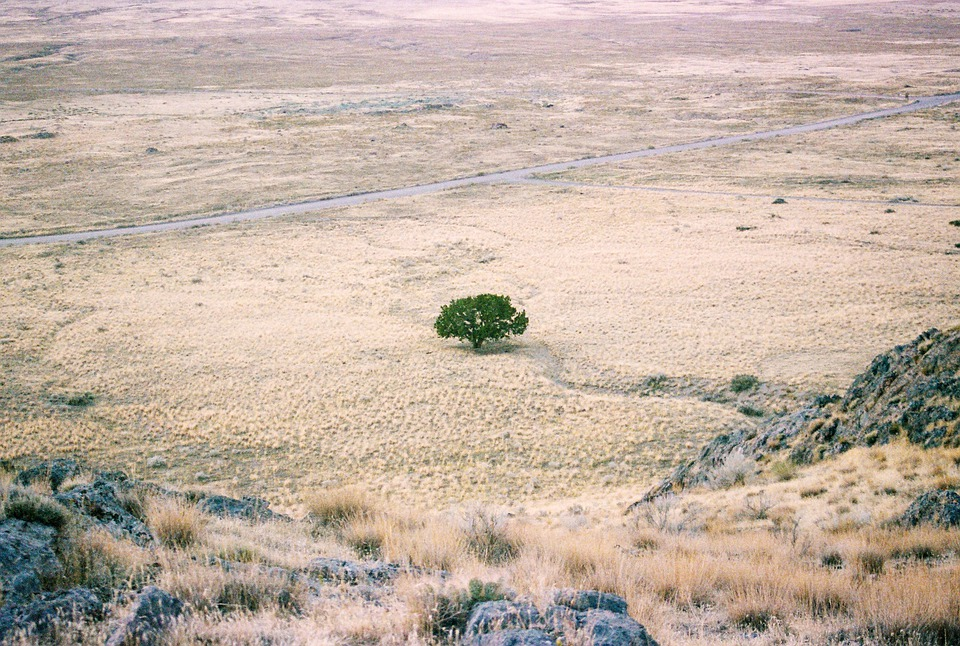

In [ ]:
cv2_imshow(tree)

In [ ]:
t= tree[290:360, 430:530]

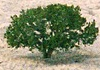

In [ ]:
cv2_imshow(t)

In [ ]:
tree[200:270, 380:480] = t

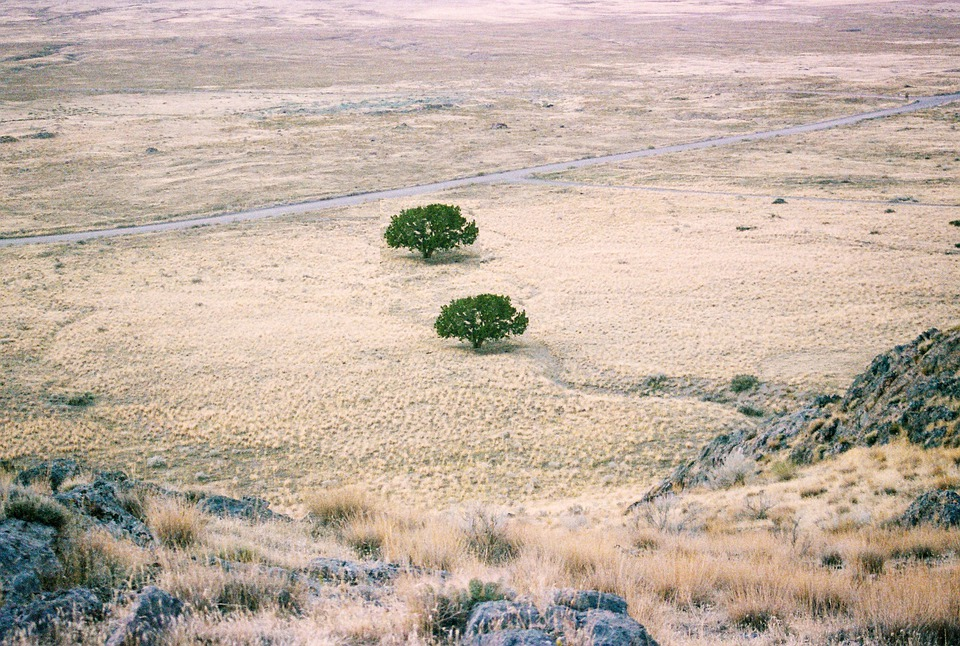

In [ ]:
cv2_imshow(tree)

In [ ]:
tree[200:270, 500:600] = t

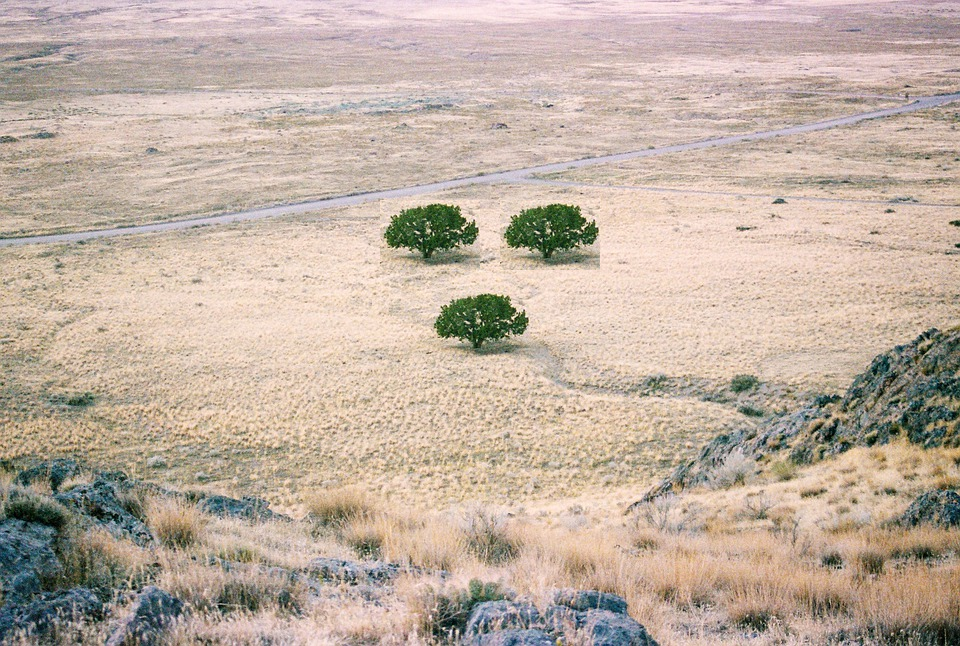

In [ ]:
cv2_imshow(tree)

## 이미지의 Channels

- B, G, R로 구성된 채널을 분리, 합칠 수 있음

  - `cv2.split()`

  - `cv2.merge()`

In [ ]:
b, g, r = cv2.split(tree)

In [ ]:
print(b)
print(b.shape)

[[172 170 173 ... 165 170 166]
 [162 162 170 ... 168 169 170]
 [149 159 173 ... 176 165 166]
 ...
 [120 111 128 ...  26  55  11]
 [115  97  82 ...  30  23  19]
 [ 93 101  81 ...  31  15  13]]
(646, 960)


In [ ]:
print(g)
print(g.shape)

[[165 162 163 ... 146 151 147]
 [155 153 160 ... 149 150 151]
 [141 149 163 ... 159 148 149]
 ...
 [101  94 117 ...  27  60  19]
 [ 93  80  71 ...  34  31  28]
 [ 71  82  70 ...  35  23  22]]
(646, 960)


In [ ]:
print(r)
print(r.shape)

[[178 173 175 ... 173 178 174]
 [170 166 172 ... 176 177 178]
 [158 165 176 ... 186 175 176]
 ...
 [ 94  91 119 ...  18  51   9]
 [ 88  77  73 ...  23  21  18]
 [ 66  79  73 ...  24  13  12]]
(646, 960)


In [ ]:
img = cv2.merge((b, g, r))

In [ ]:
print(img.shape)

(646, 960, 3)


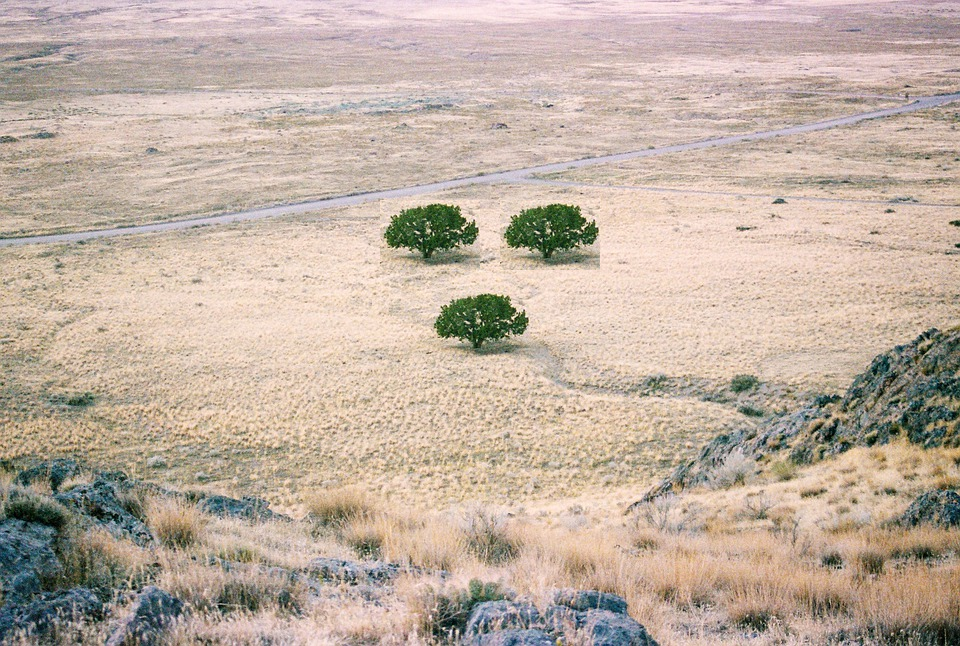

In [ ]:
cv2_imshow(img)

- `cv2.split()` 함수는 비용이 많이 드는 함수이므로, 가능하다면 **Numpy indexing**을 사용하는 효율적

- R 채널 0으로 값 변경

In [ ]:
img[:, :, 2] = 0

In [ ]:
print(img)

[[[172 165   0]
  [170 162   0]
  [173 163   0]
  ...
  [165 146   0]
  [170 151   0]
  [166 147   0]]

 [[162 155   0]
  [162 153   0]
  [170 160   0]
  ...
  [168 149   0]
  [169 150   0]
  [170 151   0]]

 [[149 141   0]
  [159 149   0]
  [173 163   0]
  ...
  [176 159   0]
  [165 148   0]
  [166 149   0]]

 ...

 [[120 101   0]
  [111  94   0]
  [128 117   0]
  ...
  [ 26  27   0]
  [ 55  60   0]
  [ 11  19   0]]

 [[115  93   0]
  [ 97  80   0]
  [ 82  71   0]
  ...
  [ 30  34   0]
  [ 23  31   0]
  [ 19  28   0]]

 [[ 93  71   0]
  [101  82   0]
  [ 81  70   0]
  ...
  [ 31  35   0]
  [ 15  23   0]
  [ 13  22   0]]]


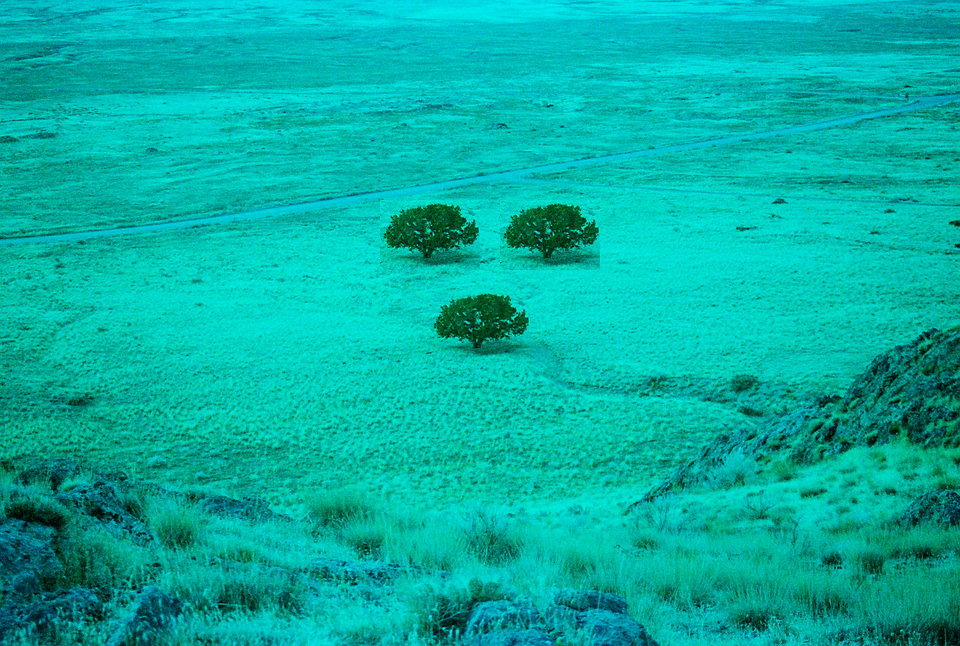

In [ ]:
cv2_imshow(img)

- G 채널 255으로 값 변경

In [ ]:
img[:, :, 1] = 0

In [ ]:
print(img)

[[[172   0   0]
  [170   0   0]
  [173   0   0]
  ...
  [165   0   0]
  [170   0   0]
  [166   0   0]]

 [[162   0   0]
  [162   0   0]
  [170   0   0]
  ...
  [168   0   0]
  [169   0   0]
  [170   0   0]]

 [[149   0   0]
  [159   0   0]
  [173   0   0]
  ...
  [176   0   0]
  [165   0   0]
  [166   0   0]]

 ...

 [[120   0   0]
  [111   0   0]
  [128   0   0]
  ...
  [ 26   0   0]
  [ 55   0   0]
  [ 11   0   0]]

 [[115   0   0]
  [ 97   0   0]
  [ 82   0   0]
  ...
  [ 30   0   0]
  [ 23   0   0]
  [ 19   0   0]]

 [[ 93   0   0]
  [101   0   0]
  [ 81   0   0]
  ...
  [ 31   0   0]
  [ 15   0   0]
  [ 13   0   0]]]


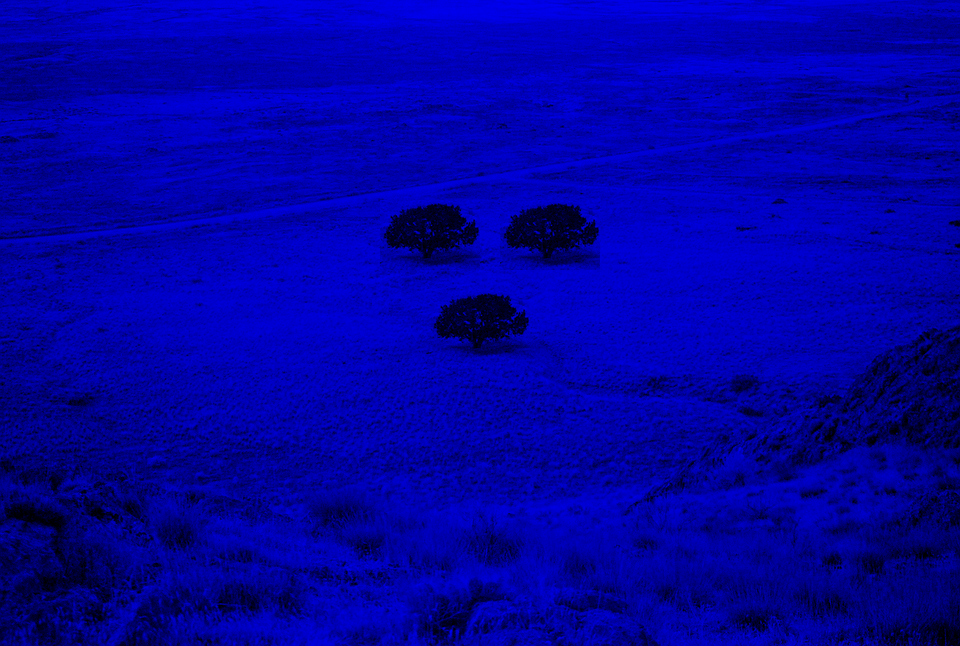

In [ ]:
cv2_imshow(img)

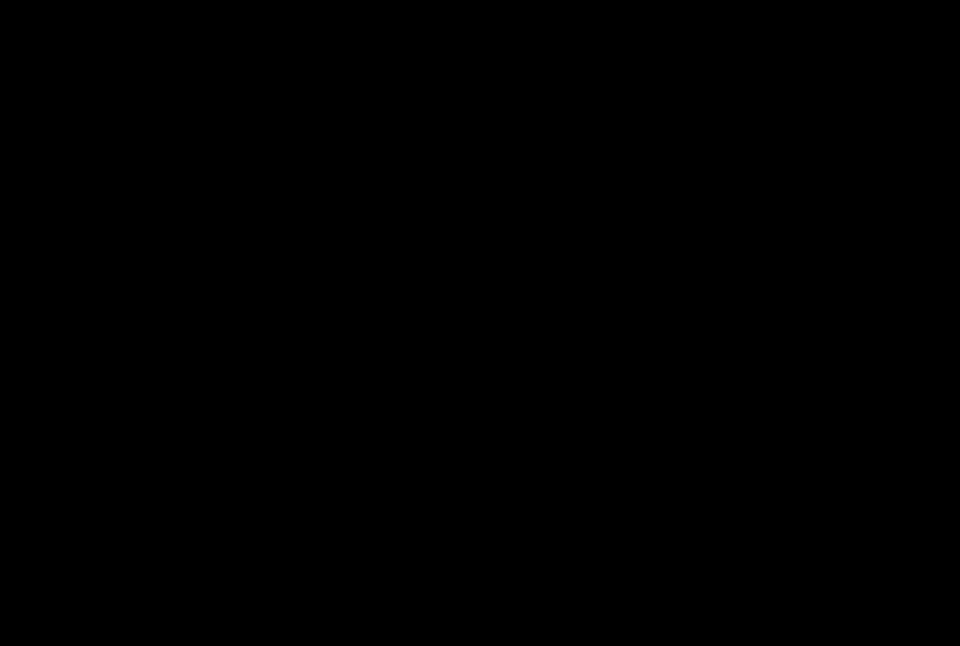

In [ ]:
img[:, :, 0] =  0
cv2_imshow(img)

## 이미지 더하기
- `cv2.add()`

- `cv2.addWeighted()`

- `Numpy` 더하기 연산

- `cv2.add()` : Saturation 연산 
  - `Saturation` 연산은 한계값을 정하고 그 값을 벗어나는 경우는 모두 특정 값으로 계산하는 방식

  - 이미지에서는 0이하는 모두 0, 255이상은 모두 255로 표현

- `Numpy` : modulo 연산
  - a와 b는 n으로 나눈 나머지 값이 같다라는 의미

  - 이미지에서는 연산의 결과가 256보다 큰 경우는 256으로 나눈 나머지 값으로 결정

In [ ]:
x = np.uint8([250])
y = np.uint8([10])

- `cv2.add()` 연산

In [ ]:
print(cv2.add(x, y))

[[255]]


- `Numpy` 연산

In [ ]:
print(x + y)

[4]


- dog1.jpg (https://cdn.pixabay.com/photo/2021/01/26/17/18/cavalier-king-charles-spaniel-5952324_960_720.jpg)

  <img src="https://cdn.pixabay.com/photo/2021/01/26/17/18/cavalier-king-charles-spaniel-5952324_960_720.jpg" width="300">

<br>

- dog2.jpg (https://cdn.pixabay.com/photo/2017/09/25/13/14/dog-2785077_960_720.jpg)

  <img src="https://cdn.pixabay.com/photo/2017/09/25/13/14/dog-2785077_960_720.jpg" width="300">


In [ ]:
!wget -O dog1.jpg https://cdn.pixabay.com/photo/2021/01/26/17/18/cavalier-king-charles-spaniel-5952324_960_720.jpg
!wget -O dog2.jpg https://cdn.pixabay.com/photo/2017/09/25/13/14/dog-2785077_960_720.jpg

--2022-02-21 13:21:20--  https://cdn.pixabay.com/photo/2021/01/26/17/18/cavalier-king-charles-spaniel-5952324_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.20.183, 104.18.21.183, 2606:4700::6812:14b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.20.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 123068 (120K) [image/jpeg]
Saving to: ‘dog1.jpg’

dog1.jpg            100%[===================>] 120.18K  --.-KB/s    in 0.01s   

2022-02-21 13:21:20 (9.12 MB/s) - ‘dog1.jpg’ saved [123068/123068]

--2022-02-21 13:21:20--  https://cdn.pixabay.com/photo/2017/09/25/13/14/dog-2785077_960_720.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.20.183, 104.18.21.183, 2606:4700::6812:14b7, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.20.183|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 138456 (135K) [image/jpeg]
Saving to: ‘dog2.jpg’

dog2.jpg            100%[===================>] 135.21K 

In [ ]:
dog1 = cv2.imread('/content/dog1.jpg', cv2.IMREAD_COLOR)
dog2 = cv2.imread('/content/dog2.jpg', cv2.IMREAD_COLOR)

In [ ]:
print(dog1.shape)
print(dog2.shape)

(640, 960, 3)
(640, 960, 3)


- `cv2.add()` 연산

In [ ]:
result1 = cv2.add(dog1, dog2)

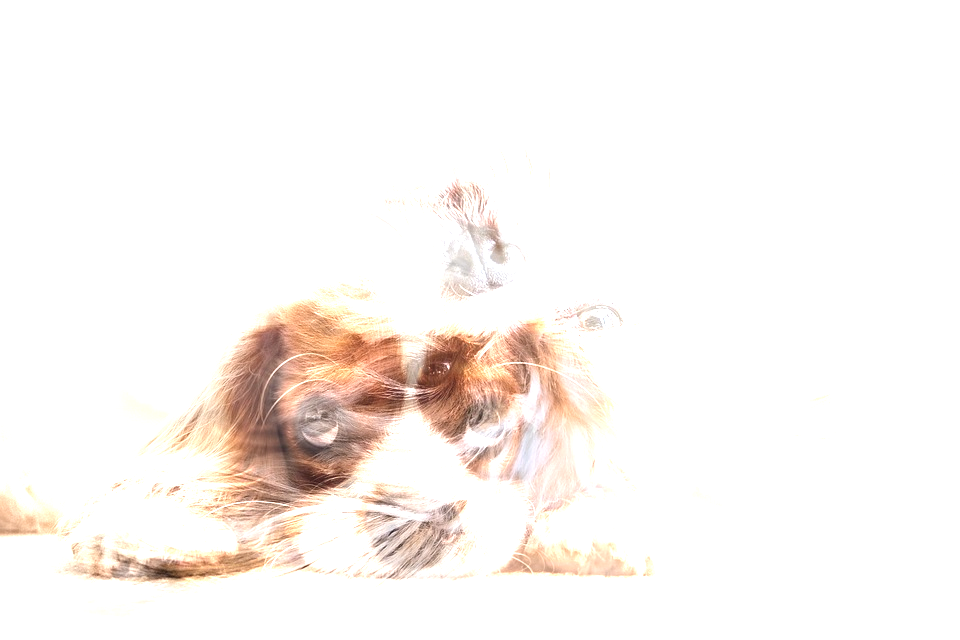

In [ ]:
cv2_imshow(result1)

- `Numpy` 연산

In [ ]:
result2 = dog1 + dog2

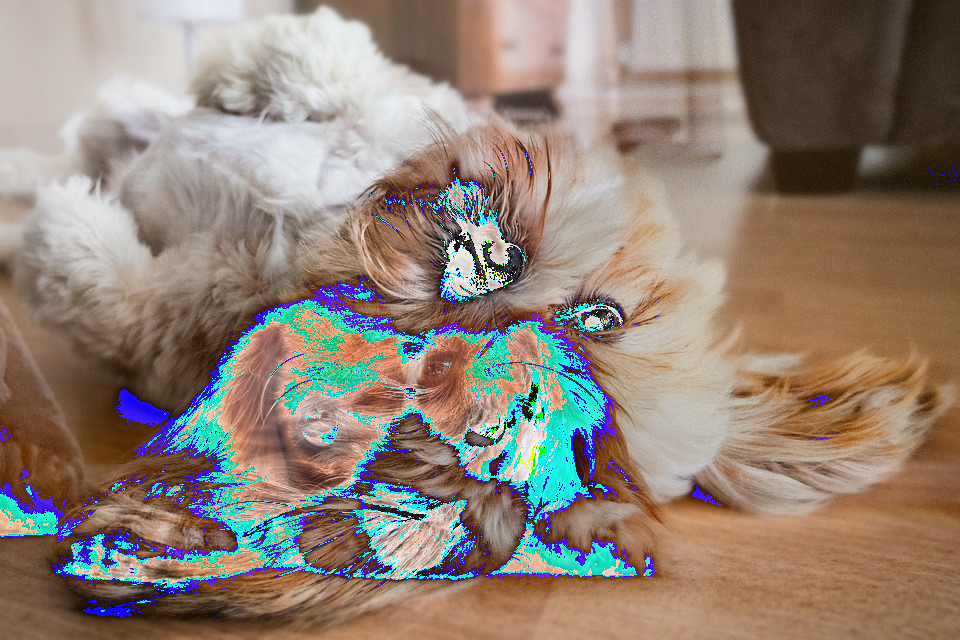

In [ ]:
cv2_imshow(result2)

## 비트 연산
- AND, OR, NOT, XOR 연산
  - `bitwise_and` : 둘다 0이 아닌 경우만 값을 통과

  - `bitwise_or` : 둘중 하나가 0이 아니면 값을 통과

  - `bitwise_not` : 해당 값에 대해 부정값을 통과

  - `bitwise_xor` : 두 요소의 논리적 배타값 통과


* star.jpg (https://static.vecteezy.com/system/resources/previews/000/440/202/original/star-vector-icon.jpg)

<img src="https://static.vecteezy.com/system/resources/previews/000/440/202/original/star-vector-icon.jpg" width="300">

In [ ]:
!wget -O star.jpg https://static.vecteezy.com/system/resources/previews/000/440/202/original/star-vector-icon.jpg

--2022-02-21 13:21:21--  https://static.vecteezy.com/system/resources/previews/000/440/202/original/star-vector-icon.jpg
Resolving static.vecteezy.com (static.vecteezy.com)... 104.18.20.35, 104.18.21.35, 2606:4700::6812:1423, ...
Connecting to static.vecteezy.com (static.vecteezy.com)|104.18.20.35|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 150183 (147K) [image/jpeg]
Saving to: ‘star.jpg’

star.jpg            100%[===================>] 146.66K  --.-KB/s    in 0.02s   

2022-02-21 13:21:21 (9.45 MB/s) - ‘star.jpg’ saved [150183/150183]



In [ ]:
star = cv2.imread('/content/star.jpg')
print(star.shape)

(5120, 5120, 3)


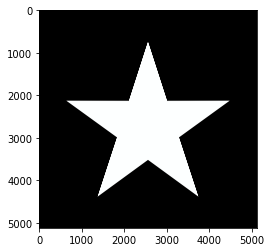

In [ ]:
plt.imshow(star)
plt.show()

In [ ]:
black_img = np.zeros([5120, 5120, 3])

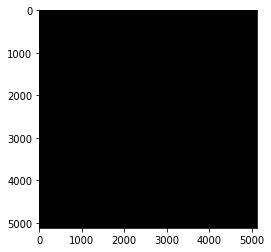

In [ ]:
plt.imshow(black_img)
plt.show()

In [ ]:
black_img[:, :2560, :] = (255, 255, 255)

- 이미지의 dtype을 int형으로 변환

In [ ]:
img = black_img.astype(np.uint8)

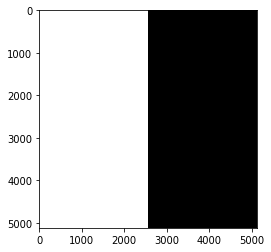

In [ ]:
plt.imshow(img)
plt.show()

### `bitwise_and` 연산

In [ ]:
result = cv2.bitwise_and(img, star)

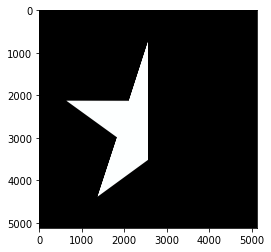

In [ ]:
plt.imshow(result)
plt.show()

### `bitwise_or` 연산

In [ ]:
result2 = cv2.bitwise_or(img, star)

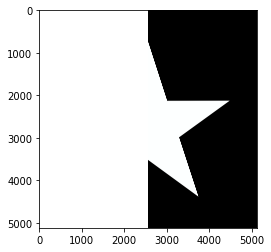

In [ ]:
plt.imshow(result2)
plt.show()

### `bitwise_not` 연산

In [ ]:
result3 = cv2.bitwise_not(img)

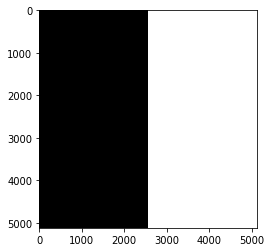

In [ ]:
plt.imshow(result3)
plt.show()

In [ ]:
result4 = cv2.bitwise_not(star)

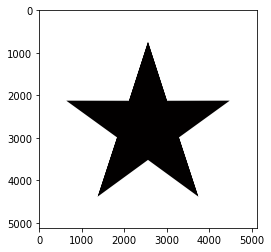

In [ ]:
plt.imshow(result4)
plt.show()

### `bitwise_xor` 연산

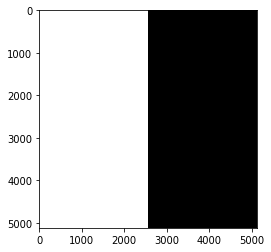

In [ ]:
plt.imshow(img)
plt.show()

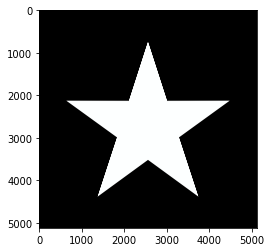

In [ ]:
plt.imshow(star)
plt.show()

In [ ]:
result5 = cv2.bitwise_xor(star, img)

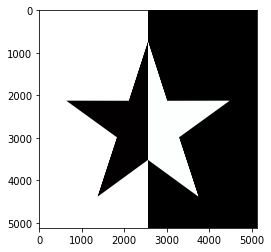

In [ ]:
plt.imshow(result5)
plt.show()

In [ ]:
tmp_star = cv2.bitwise_not(star)
result6 = cv2.bitwise_xor(tmp_star, img)

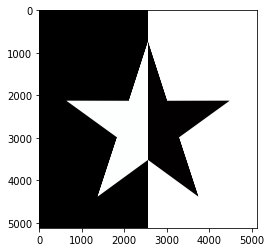

In [ ]:
plt.imshow(result6)
plt.show()

### 비트 연산 예시

- 이미지에 OpenCV 로고 넣기

- sunset.jpg (https://www.publicdomainpictures.net/pictures/260000/nahled/man-sunset-city-silhouette.jpg)

  <img src="https://www.publicdomainpictures.net/pictures/260000/nahled/man-sunset-city-silhouette.jpg" width="300">

- opencv.png (https://images.velog.io/images/seonghun-dev/post/72db176a-a9e5-492f-a484-7024388098cc/opencv_logo_icon_170888.png)

  <img src="https://images.velog.io/images/seonghun-dev/post/72db176a-a9e5-492f-a484-7024388098cc/opencv_logo_icon_170888.png" width="300">

In [ ]:
!wget -O sunset.jpg https://www.publicdomainpictures.net/pictures/260000/nahled/man-sunset-city-silhouette.jpg
!wget -O opencv.png https://images.velog.io/images/seonghun-dev/post/72db176a-a9e5-492f-a484-7024388098cc/opencv_logo_icon_170888.png

--2022-02-21 13:21:59--  https://www.publicdomainpictures.net/pictures/260000/nahled/man-sunset-city-silhouette.jpg
Resolving www.publicdomainpictures.net (www.publicdomainpictures.net)... 104.20.45.162, 104.20.44.162, 172.67.2.204, ...
Connecting to www.publicdomainpictures.net (www.publicdomainpictures.net)|104.20.45.162|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45457 (44K) [image/jpeg]
Saving to: ‘sunset.jpg’

sunset.jpg          100%[===================>]  44.39K  --.-KB/s    in 0.001s  

2022-02-21 13:21:59 (80.7 MB/s) - ‘sunset.jpg’ saved [45457/45457]

--2022-02-21 13:21:59--  https://images.velog.io/images/seonghun-dev/post/72db176a-a9e5-492f-a484-7024388098cc/opencv_logo_icon_170888.png
Resolving images.velog.io (images.velog.io)... 52.84.159.116, 52.84.159.58, 52.84.159.16, ...
Connecting to images.velog.io (images.velog.io)|52.84.159.116|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15467 (15K) [image/png]
Saving to

In [ ]:
sunset = cv2.imread('/content/sunset.jpg')
print(sunset.shape)

(386, 615, 3)


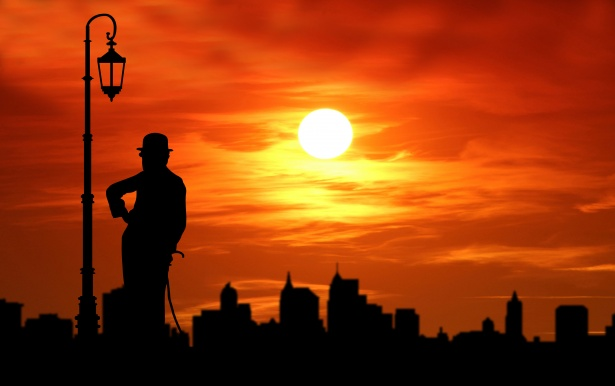

In [ ]:
cv2_imshow(sunset)

- 삽입할 이미지의 row, col, channel정보

- 대상 이미지에서 삽입할 이미지의 영역을 추출

In [ ]:
opencv = cv2.imread('/content/opencv.png')
print(opencv.shape)

(407, 749, 3)


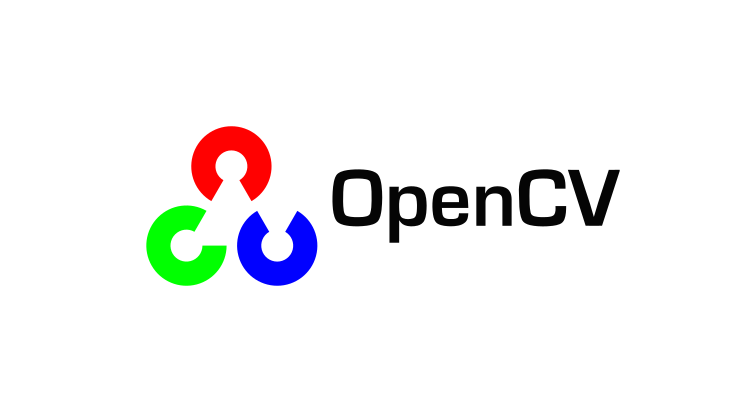

In [ ]:
cv2_imshow(opencv)

In [ ]:
rows, cols, channels = sunset.shape
opencv = opencv[0:rows, 0:cols]

In [ ]:
opencv.shape

(386, 615, 3)

- mask를 만들기 위해서 logo 이미지를 gray scale로 변경후 binary image로 전환

- mask는 logo부분이 흰색(255), 바탕은 검은색(0)

- mask_inv는 logo부분이 검은색(0), 바탕은 흰색(255)

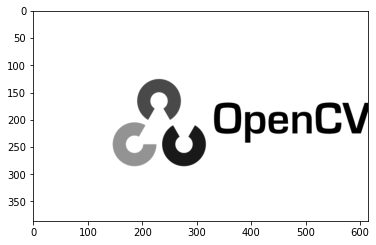

In [ ]:
opencv_gray = cv2.cvtColor(opencv, cv2.COLOR_BGR2GRAY)
plt.imshow(opencv_gray, cmap='gray')
plt.show()

In [ ]:
ret, mask = cv2.threshold(opencv_gray, 200, 255, cv2.THRESH_BINARY_INV)
mask_inv = cv2.bitwise_not(mask)

In [ ]:
print(mask)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


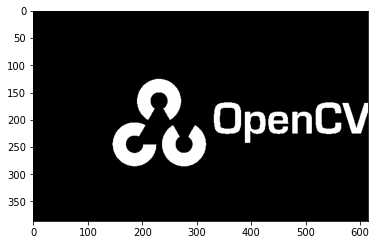

In [ ]:
plt.imshow(mask, cmap='gray')
plt.show()

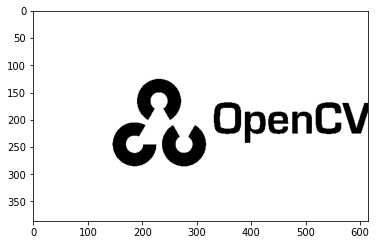

In [ ]:
plt.imshow(mask_inv, cmap='gray')
plt.show()

In [ ]:
img1_fg = cv2.bitwise_and(opencv, opencv, mask=mask)
img2_fg = cv2.bitwise_and(sunset, sunset, mask=mask_inv)

In [ ]:
dst = cv2.add(img1_fg, img2_fg)

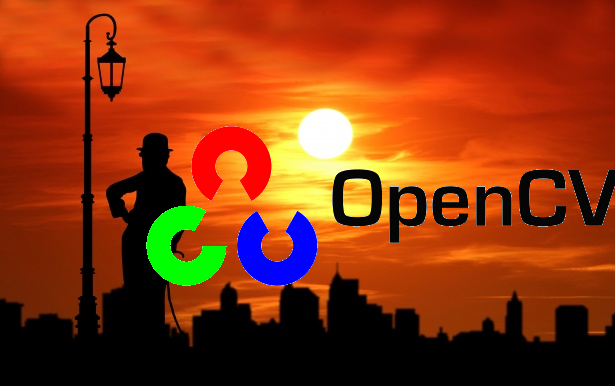

In [ ]:
cv2_imshow(dst)

In [ ]:
sunset[0:rows, 0:cols] = dst

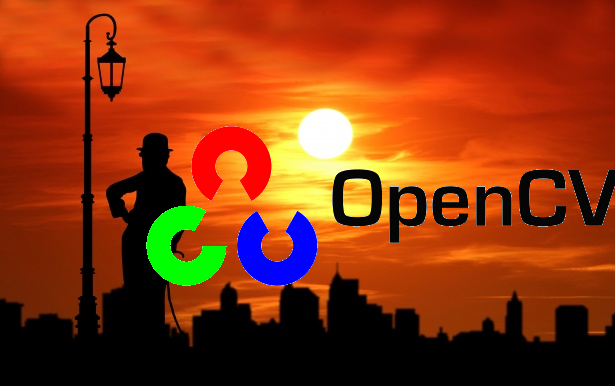

In [ ]:
cv2_imshow(sunset)

# 참고

* 코드 참조 : https://opencv-python.readthedocs.io/en/latest/index.html